## Colab setup & dataset download (Roboflow → YOLOv8)


In [ ]:
from IPython.display import clear_output
clear_output()
import os, json, shutil, random, glob
from pathlib import Path
import torch, os, glob, random, yaml, numpy as np
from IPython.display import display

In [ ]:
# --- Clean install for NumPy 2.x compatible stack ---
%pip -q install -U pip setuptools wheel

# Remove conflicting builds
%pip -q uninstall -y numpy ultralytics onnx onnxruntime onnxruntime-gpu roboflow opencv-python opencv-python-headless > /dev/null

# Install NumPy 2 and libs that support it
%pip -q install "numpy==2.0.2" \
                "opencv-python-headless>=4.10.0.84" \
                "ultralytics>=8.3.184" \
                "onnx>=1.16.0" \
                "onnxruntime-gpu>=1.18.0" \
                "roboflow>=1.2.6" \
                ipywidgets>=8.1

#import IPython; IPython.get_ipython().kernel.do_shutdown(True)  # will restart kernel


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.8/1.8 MB 22.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 MB 70.8 MB/s eta 0:00:00
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
ipython 7.34.0 requires jedi>=0.16, which is not installed.


In [ ]:
import numpy, cv2, onnxruntime as ort, ultralytics, roboflow
print("numpy", numpy.__version__)
print("cv2", cv2.__version__)
print("onnxruntime providers:", ort.get_available_providers())
print("ultralytics", ultralytics.__version__)
import roboflow as rf; print("roboflow", rf.__version__)


Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.
numpy 2.0.2
cv2 4.12.0
onnxruntime providers: ['TensorrtExecutionProvider', 'CUDAExecutionProvider', 'CPUExecutionProvider']
ultralytics 8.3.186
roboflow 1.2.6


##Gpu info

In [ ]:
gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('Not connected to a GPU')
else:
  print(gpu_info)

Mon Aug 25 17:53:16 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 550.54.15              Driver Version: 550.54.15      CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  NVIDIA A100-SXM4-40GB          Off |   00000000:00:04.0 Off |                    0 |
| N/A   37C    P0             53W /  400W |       0MiB /  40960MiB |      0%      Default |
|                                         |                        |             Disabled |
+-----------------------------------------+-----

##Roboflow: download the dataset you referenced (YOLOv8 format)

In [ ]:
from roboflow import Roboflow
rf = Roboflow(api_key="ouWxulB15Sf3lsOjdSQD")
project = rf.workspace("roboflow-universe-projects").project("license-plate-recognition-rxg4e")
version = project.version(11)
dataset = version.download("yolov8")
data_dir = Path(dataset.location)
data_dir

loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to License-Plate-Recognition-11 in yolov8:: 100%|██████████| 20262/20262 [00:02<00:00, 7763.90it/s]


PosixPath('/content/License-Plate-Recognition-11')

##Inspect and show the dataset YAML path (Ultralytics uses this)

In [ ]:
data_dir = Path("/content/License-Plate-Recognition-11")
yaml_path = next(data_dir.glob("*.yaml"))
print("Dataset YAML ->", yaml_path)
display(yaml.safe_load(open(yaml_path)))

Dataset YAML -> /content/License-Plate-Recognition-11/data.yaml


{'names': ['License_Plate'],
 'nc': 1,
 'roboflow': {'license': 'CC BY 4.0',
  'project': 'license-plate-recognition-rxg4e',
  'url': 'https://universe.roboflow.com/roboflow-universe-projects/license-plate-recognition-rxg4e/dataset/11',
  'version': 11,
  'workspace': 'roboflow-universe-projects'},
 'test': '../test/images',
 'train': '../train/images',
 'val': '../valid/images'}

In [ ]:
from ultralytics import YOLO
import torch

%pip -q install -U wandb
import os, wandb
os.environ.pop("WANDB_DISABLED", None)       # ensure not disabled
os.environ.pop("WANDB_MODE", None)           # ensure not offline/dryrun
wandb.login(relogin=True)                    # will prompt or reuse your key

from ultralytics import settings as yolo_settings
yolo_settings.update({'wandb': True})


MODEL_VARIANT = "n"            # try 's' after this works (more accurate, slower)
IMGSZ = 416
EPOCHS = 50
BATCH = 16 if torch.cuda.is_available() else 8

model = YOLO(f"yolov8{MODEL_VARIANT}.pt")
results = model.train(
    data=str(yaml_path),
    imgsz=IMGSZ,
    epochs=EPOCHS,
    batch=BATCH,
    patience=20,
    device=0 if torch.cuda.is_available() else "cpu",
    optimizer="SGD",
    lr0=0.01,
    weight_decay=5e-4,
    hsv_h=0.015, hsv_s=0.7, hsv_v=0.4,
    mosaic=1.0
)

# Optional: print the URL of the W&B run immediately
if wandb.run:
    print("W&B run:", wandb.run.get_url())

invalid escape sequence '\/'


<IPython.core.display.Javascript object>

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter:

 ··········


wandb: WARNING If you're specifying your api key in code, ensure this code is not shared publicly.
wandb: WARNING Consider setting the WANDB_API_KEY environment variable, or running `wandb login` from the command line.
wandb: No netrc file found, creating one.
wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc
wandb: Currently logged in as: trinc-ciprian (trinc-ciprian-universitatea-de-vest-din-timisoara) to https://api.wandb.ai. Use `wandb login --relogin` to force relogin


Ultralytics 8.3.186 🚀 Python-3.12.11 torch-2.8.0+cu126 CUDA:0 (NVIDIA A100-SXM4-40GB, 40507MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/License-Plate-Recognition-11/data.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=50, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=416, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8n.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=train, nbs=64, nms=False, opset=None, optimize=False, optimizer=SGD, overlap_mask=True, patience=20, perspective=0.0, plots=

Overriding model.yaml nc=80 with nc=1

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      7360  ultralytics.nn.modules.block.C2f             [32, 32, 1, True]             
  3                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  4                  -1  2     49664  ultralytics.nn.modules.block.C2f             [64, 64, 2, True]             
  5                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  6                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  7                  -1  1    295424  ultralytics

lr/pg0,█▅▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
lr/pg1,▃▆███▇▇▇▇▇▇▆▆▆▆▆▅▅▅▅▅▅▄▄▄▄▄▄▃▃▃▃▂▂▂▂▂▁▁▁
lr/pg2,▃████▇▇▇▇▇▆▆▆▆▆▅▅▅▅▅▅▄▄▄▄▄▄▃▃▃▃▃▂▂▂▂▂▁▁▁
metrics/mAP50(B),▂▁▃▄▄▂▅▅▅▆▆▆▇▇▆▇▇▇▆▇▇▇▇▇▇▇▇█████▇███████
metrics/mAP50-95(B),▃▃▁▄▄▄▄▅▅▅▆▆▆▇▆▇▇▇▇▇▇▇▇▇▇▇▇▇▇▇██▇███████
metrics/precision(B),▄▄▁▅▇▆▆▆▆▇▇█▇▇██▇▇█▇█▇▇▇▇▇█▇█▇██▇███████
metrics/recall(B),▄▄▁▃▃▅▄▅▅▆▆▆▆▆▆▆▇▆▆▇▇▇▇▇▇▇▇███▇█▇▇█▇▇▇██
model/GFLOPs,▁
model/parameters,▁
model/speed_PyTorch(ms),▁
train/box_loss,█▇██▇▆▆▆▆▅▅▅▅▅▅▄▄▄▄▄▄▄▃▃▃▃▃▃▃▃▃▂▂▂▂▂▂▁▁▁


##Validate + quick visual *checks*

In [ ]:
# 1) Enable W&B in Ultralytics
from ultralytics import settings as yolo_settings
yolo_settings.update({'wandb': True})

# 2) (optional) login once per session
import wandb; wandb.login(relogin=True)

# 3) Log a fresh run by validating your best checkpoint
from ultralytics import YOLO
best_pt = "runs/detect/train/weights/best.pt"  # adjust if different
model = YOLO(best_pt)
metrics = model.val(imgsz=640, name="val_wandb_run")  # creates a W&B run
print(metrics.results_dict)

from IPython.display import Image, display
import os

run_dir = "runs/detect/train2"  # adjust if needed
for f in ["results.png", "confusion_matrix.png", "PR_curve.png", "F1_curve.png"]:
    path = os.path.join(run_dir, f)
    if os.path.exists(path):
        display(Image(filename=path, width=800))


# metrics (mAP, precision, recall, etc.)
metrics = model.val(data=str(yaml_path), imgsz=IMGSZ)
print(metrics.results_dict)

# visualize predictions on a handful of val images
val_imgs = glob.glob(f"{data_dir}/valid/images/*")
sample = random.sample(val_imgs, k=min(8, len(val_imgs)))
preds = model.predict(sample, imgsz=IMGSZ, conf=0.25, save=True, project="pred_samples", name="run")
print("Saved examples under: pred_samples/run")

<IPython.core.display.Javascript object>

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter:

 ··········


wandb: WARNING If you're specifying your api key in code, ensure this code is not shared publicly.
wandb: WARNING Consider setting the WANDB_API_KEY environment variable, or running `wandb login` from the command line.
wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


Ultralytics 8.3.186 🚀 Python-3.12.11 torch-2.8.0+cu126 CUDA:0 (NVIDIA A100-SXM4-40GB, 40507MiB)
Model summary (fused): 72 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 700.5±181.7 MB/s, size: 19.8 KB)
val: Scanning /content/License-Plate-Recognition-11/valid/labels.cache... 2048 images, 3 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 2048/2048 4310052.5it/s 0.0s
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 128/128 14.5it/s 8.8s
                   all       2048       2195      0.966      0.935      0.963      0.665
Speed: 0.1ms preprocess, 1.0ms inference, 0.0ms loss, 0.9ms postprocess per image
Results saved to runs/detect/val_wandb_run
{'metrics/precision(B)': 0.9660934496390103, 'metrics/recall(B)': 0.9346166791420323, 'metrics/mAP50(B)': 0.9630500394133368, 'metrics/mAP50-95(B)': 0.6651463113608332, 'fitness': 0.6949366841660836}
Ultralytics 8.3.186 🚀 Python-3.12.11 

##Plot metrics directly in Python

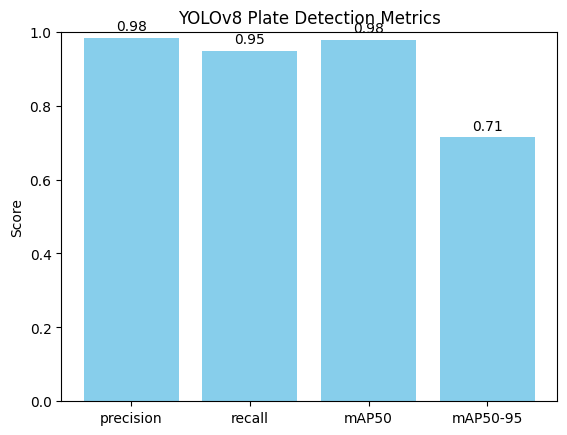

In [ ]:
import matplotlib.pyplot as plt

metrics = {
 'precision': 0.983,
 'recall':    0.949,
 'mAP50':     0.977,
 'mAP50-95':  0.714
}

plt.bar(metrics.keys(), metrics.values(), color="skyblue")
plt.ylim(0,1)
plt.ylabel("Score")
plt.title("YOLOv8 Plate Detection Metrics")
for k,v in metrics.items():
    plt.text(k, v+0.02, f"{v:.2f}", ha="center")
plt.show()


##Quick check ONNX

##Export NMS‑free ONNX (needed for Hailo‑NMS later)

In [ ]:
best_pt = Path("runs/detect/train/weights/best.pt")
assert best_pt.exists(), "best.pt not found — check training run path."
onnx_path = YOLO(str(best_pt)).export(
    format="onnx",
    dynamic=False,       # static shapes
    opset=11,            # 12/13 OK
    imgsz=IMGSZ,
    half=False,          # keep FP32; Hailo will quantize
    simplify=True,
    nms=False            # <-- IMPORTANT: no builtin NMS
)
print("ONNX exported to:", onnx_path)

Ultralytics 8.3.186 🚀 Python-3.12.11 torch-2.8.0+cu126 CPU (Intel Xeon 2.20GHz)
💡 ProTip: Export to OpenVINO format for best performance on Intel hardware. Learn more at https://docs.ultralytics.com/integrations/openvino/
Model summary (fused): 72 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs

PyTorch: starting from 'runs/detect/train/weights/best.pt' with input shape (1, 3, 416, 416) BCHW and output shape(s) (1, 5, 3549) (5.9 MB)
requirements: Ultralytics requirements ['onnx>=1.12.0,<1.18.0', 'onnxslim>=0.1.59'] not found, attempting AutoUpdate...

requirements: AutoUpdate success ✅ 2.5s
WARNING ⚠️ requirements: Restart runtime or rerun command for updates to take effect


ONNX: starting export with onnx 1.17.0 opset 11...
ONNX: slimming with onnxslim 0.1.65...
ONNX: export success ✅ 3.7s, saved as 'runs/detect/train/weights/best.onnx' (11.6 MB)

Export complete (4.1s)
Results saved to /content/runs/detect/train/weights
Predict:         yolo predict task=detect model=runs/dete

In [ ]:
import onnx, onnxruntime as ort
m = onnx.load(onnx_path); onnx.checker.check_model(m)
sess = ort.InferenceSession(str(onnx_path), providers=["CUDAExecutionProvider","CPUExecutionProvider"])
print("Input:", sess.get_inputs()[0].name, sess.get_inputs()[0].shape)
for o in sess.get_outputs():
    print("Output:", o.name, o.shape)


Input: images [1, 3, 416, 416]
Output: output0 [1, 5, 3549]


##Build a calibration set (for Hailo quantization)

In [ ]:
import cv2, os
calib_dir = Path("calib_npys"); calib_dir.mkdir(exist_ok=True)

def preprocess(path, size=IMGSZ):
    im = cv2.imread(path)[..., ::-1]     # BGR->RGB
    im = cv2.resize(im, (size, size))
    im = im.astype("float32")/255.0
    im = np.transpose(im, (2,0,1))       # HWC->CHW
    return im[None]                      # NCHW, batch=1

train_imgs = glob.glob(f"{data_dir}/train/images/*")
val_imgs   = glob.glob(f"{data_dir}/valid/images/*")
all_imgs = train_imgs + val_imgs
random.shuffle(all_imgs)
subset = all_imgs[:300] if len(all_imgs) >= 300 else all_imgs

for i, p in enumerate(subset):
    np.save(calib_dir/f"calib_{i:04d}.npy", preprocess(p))

print("Calib samples:", len(list(calib_dir.glob('*.npy'))))

Calib samples: 300


##(Off‑Colab) Compile to .HEF for Hailo‑8L

# Variables
MODEL_ONNX=/path/to/yolov8_plate.onnx
CALIB_DIR=/path/to/calib_npys
OUTDIR=/path/to/out
mkdir -p "$OUTDIR"

# Compile ONNX -> HEF with Hailo-NMS and batch=1 for Hailo-8L
hailomz compile custom_yolov8_lpr \
  --ckpt "$MODEL_ONNX" \
  --hw-arch hailo8l \
  --batch-size 1 \
  --calib-path "$CALIB_DIR" \
  --calib-format npy_dir \
  --nms \
  --output "$OUTDIR/custom_yolov8_lpr.hef" \
  --profile

In [ ]:
# --- Setup (run once) ---
# Point to the latest training run
run_dir = sorted(Path("runs/detect").glob("train"), key=lambda p: p.stat().st_mtime)[-1]
best_pt = run_dir / "weights" / "best.pt"
print("Using:", best_pt)

model = YOLO(str(best_pt))
IMGSZ = 640

Using: runs/detect/train/weights/best.pt


## 1) Test in Colab with your trained YOLO (image)


image 1/1 /content/License-Plate-Recognition-11/valid/images/xemay351_jpg.rf.d165fe690c68a468efe104cf73ce4d27.jpg: 416x640 1 License_Plate, 65.1ms
Speed: 1.8ms preprocess, 65.1ms inference, 1.6ms postprocess per image at shape (1, 3, 416, 640)
Results saved to demo_out/image
Saved prediction to: demo_out/image


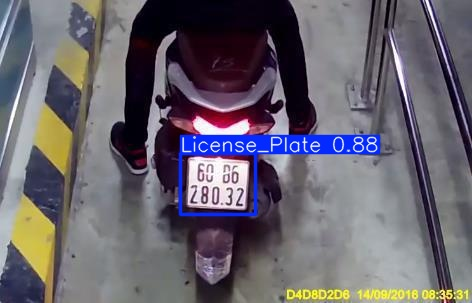

In [ ]:
from pathlib import Path
import glob, random, IPython.display as disp# Option A: use a dataset image
img_path = random.choice(glob.glob("/content/License-Plate-Recognition-11/valid/images/*"))

# Option B: upload your own image
# from google.colab import files
# up = files.upload()  # pick a local .jpg/.png
# img_path = list(up.keys())[0]

res = model.predict(img_path, imgsz=IMGSZ, conf=0.25, save=True, project="demo_out", name="image")
print("Saved prediction to:", "demo_out/image")
disp.Image(filename=str(next((Path("demo_out/image")).glob("*.jpg"))))


#### 2) Test in Colab with your trained YOLO (image & video)

Using model: runs/detect/train/weights/best.pt
Testing on: /content/License-Plate-Recognition-11/valid/images/xemay2175_jpg.rf.f67a41bf991440fab0180fac4e691a67.jpg

image 1/1 /content/License-Plate-Recognition-11/valid/images/xemay2175_jpg.rf.f67a41bf991440fab0180fac4e691a67.jpg: 416x640 1 License_Plate, 9.4ms
Speed: 1.9ms preprocess, 9.4ms inference, 2.1ms postprocess per image at shape (1, 3, 416, 640)
Results saved to single_test_out/pred
Rendered with boxes -> single_test_out/pred/xemay2175_jpg.rf.f67a41bf991440fab0180fac4e691a67.jpg


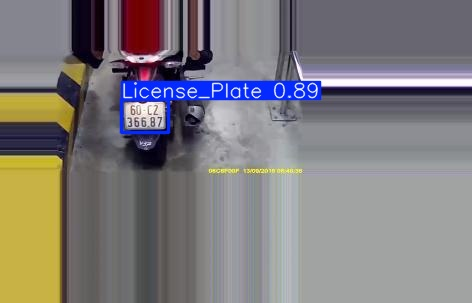

In [ ]:
from ultralytics import YOLO
from pathlib import Path
import glob, random, cv2, numpy as np
import IPython.display as disp

# --- paths ---
DATA_DIR = Path("/content/License-Plate-Recognition-11")
IMG_DIR  = DATA_DIR / "valid" / "images"     # you can switch to "test/images"
RUNS_DIR = Path("runs/detect")
OUT_DIR  = Path("single_test_out"); OUT_DIR.mkdir(exist_ok=True, parents=True)

# --- load best checkpoint from the latest training run ---
run_dir = sorted(RUNS_DIR.glob("train"), key=lambda p: p.stat().st_mtime)[-1]
best_pt = run_dir / "weights" / "best.pt"
print("Using model:", best_pt)
model = YOLO(str(best_pt))
IMGSZ = 640

# --- pick ONE image ---
all_imgs = sorted(glob.glob(str(IMG_DIR/"*")))
assert all_imgs, f"No images found in {IMG_DIR}"
img_path = random.choice(all_imgs)
print("Testing on:", img_path)

# --- run detection & save Ultralytics-rendered result ---
res = model.predict(
    source=img_path,
    imgsz=IMGSZ,
    conf=0.25,
    save=True,
    project=str(OUT_DIR),
    name="pred"
)[0]

# the rendered image Ultralytics saved:
rendered = next((OUT_DIR / "pred").glob("*.jpg"))
print("Rendered with boxes ->", rendered)
disp.Image(filename=str(rendered), width=900)


## 3) Test in Colab with your trained YOLO (video)

In [ ]:
# OCR step (host-side). Install once:
%pip -q install easyocr > /dev/null

import easyocr
reader = easyocr.Reader(['en'])  # add locale codes if needed, e.g., ['en','ro','de']

# Load original image (BGR)
img_bgr = cv2.imread(img_path)
h, w = img_bgr.shape[:2]

# Copy for drawing OCR text
annot = img_bgr.copy()

# Iterate detections
texts = []
for b, conf, cls in zip(res.boxes.xyxy.cpu().numpy().astype(int),
                        res.boxes.conf.cpu().numpy(),
                        res.boxes.cls.cpu().numpy()):
    x1, y1, x2, y2 = b
    # clamp to image bounds
    x1, y1 = max(0,x1), max(0,y1)
    x2, y2 = min(w-1,x2), min(h-1,y2)
    crop = img_bgr[y1:y2, x1:x2]

    # OCR
    ocr_res = reader.readtext(crop)
    # pick the highest-score string if any
    if len(ocr_res):
        best = max(ocr_res, key=lambda t: t[2])  # (bbox, text, score)
        plate_text, score = best[1], best[2]
    else:
        plate_text, score = "", 0.0

    texts.append((b, plate_text, float(score), float(conf)))

    # Draw box + OCR text
    cv2.rectangle(annot, (x1,y1), (x2,y2), (0,255,0), 2)
    label = f"{plate_text if plate_text else 'plate'}  conf:{conf:.2f}  ocr:{score:.2f}"
    cv2.putText(annot, label, (x1, max(0,y1-8)), cv2.FONT_HERSHEY_SIMPLEX, 0.6, (0,255,0), 2)

# Save and show
annot_path = OUT_DIR / "pred_with_ocr.jpg"
cv2.imwrite(str(annot_path), annot)
print("Annotated (with OCR) ->", annot_path)
disp.Image(filename=str(annot_path), width=900)

# Also print the raw detections + OCR strings
for b, plate_text, ocr_s, det_c in texts:
    print(f"Box {b}  det_conf={det_c:.2f}  OCR='{plate_text}'  ocr_conf={ocr_s:.2f}")


Progress: |██████████████████████████████████████████████████| 100.0% Complete

Progress: |██████████████████████████████████████████████████| 100.0% CompleteAnnotated (with OCR) -> single_test_out/pred_with_ocr.jpg
Box [121  99 168 132]  det_conf=0.89  OCR='366,874'  ocr_conf=0.28


In [ ]:
from pathlib import Path

# Look under runs/detect/
list(Path("runs/detect").glob("train*"))


[PosixPath('runs/detect/train')]

## locate

In [ ]:
run_dir = sorted(Path("runs/detect").glob("train"), key=lambda p: p.stat().st_mtime)[-1]
print("Using run:", run_dir)
best_pt = run_dir / "weights" / "best.pt"
print("Best checkpoint exists:", best_pt.exists(), best_pt)


Using run: runs/detect/train
Best checkpoint exists: True runs/detect/train/weights/best.pt


##Export to ONNX (no NMS)

In [ ]:
from ultralytics import YOLO

model = YOLO(str(best_pt))
onnx_path = model.export(
    format="onnx",
    dynamic=False,
    opset=12,
    imgsz=640,
    half=False,
    simplify=True,
    nms=False    # important for Hailo
)

print("Exported ONNX path:", onnx_path)


Ultralytics 8.3.186 🚀 Python-3.12.11 torch-2.8.0+cu126 CPU (Intel Xeon 2.20GHz)
Model summary (fused): 72 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs

PyTorch: starting from 'runs/detect/train/weights/best.pt' with input shape (1, 3, 640, 640) BCHW and output shape(s) (1, 5, 8400) (5.9 MB)

ONNX: starting export with onnx 1.17.0 opset 12...
ONNX: slimming with onnxslim 0.1.65...
ONNX: export success ✅ 1.6s, saved as 'runs/detect/train/weights/best.onnx' (11.7 MB)

Export complete (1.9s)
Results saved to /content/runs/detect/train/weights
Predict:         yolo predict task=detect model=runs/detect/train/weights/best.onnx imgsz=640  
Validate:        yolo val task=detect model=runs/detect/train/weights/best.onnx imgsz=640 data=/content/License-Plate-Recognition-11/data.yaml  
Visualize:       https://netron.app
Exported ONNX path: runs/detect/train/weights/best.onnx


In [ ]:
list((run_dir / "weights").glob("*.onnx"))


[PosixPath('runs/detect/train/weights/best.onnx')]

##Test the ONNX

In [ ]:
import onnx, onnxruntime as ort, numpy as np

onnx_path = str(run_dir / "weights" / "best.onnx")
m = onnx.load(onnx_path); onnx.checker.check_model(m)

sess = ort.InferenceSession(onnx_path, providers=["CPUExecutionProvider"])
inp = sess.get_inputs()[0].name
print("Input:", inp, sess.get_inputs()[0].shape)

dummy = np.random.rand(1,3,640,640).astype("float32")
_ = sess.run(None, {inp: dummy})
print("ONNX forward pass OK")


Input: images [1, 3, 640, 640]
ONNX forward pass OK


In [ ]:
from pathlib import Path
import glob, random, cv2, numpy as np

DATA_DIR = Path("/content/License-Plate-Recognition-11")
IMGSZ = 640
CALIB_DIR = Path("calib_npys"); CALIB_DIR.mkdir(exist_ok=True, parents=True)

def preprocess(path, size=IMGSZ):
    im = cv2.imread(path)[..., ::-1]         # BGR->RGB
    im = cv2.resize(im, (size, size))
    im = (im.astype("float32")/255.0).transpose(2,0,1)  # CHW
    return im[None]                           # NCHW

train_imgs = glob.glob(str(DATA_DIR/"train/images/*"))
val_imgs   = glob.glob(str(DATA_DIR/"valid/images/*"))
all_imgs = train_imgs + val_imgs
random.shuffle(all_imgs)
subset = all_imgs[:300] if len(all_imgs) >= 300 else all_imgs

for i, p in enumerate(subset):
    np.save(CALIB_DIR/f"calib_{i:04d}.npy", preprocess(p))

len(list(CALIB_DIR.glob("*.npy")))


300

Testing on: /content/License-Plate-Recognition-11/valid/images/xemay38_jpg.rf.8307d0b6b881a9c2116f146093bbd3da.jpg

image 1/1 /content/License-Plate-Recognition-11/valid/images/xemay38_jpg.rf.8307d0b6b881a9c2116f146093bbd3da.jpg: 416x640 1 License_Plate, 7.2ms
Speed: 1.7ms preprocess, 7.2ms inference, 1.6ms postprocess per image at shape (1, 3, 416, 640)
Results saved to demo_out/image2
Saved: demo_out/image


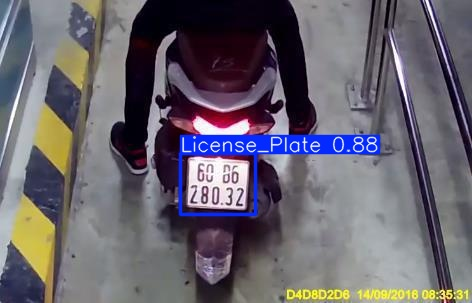

In [ ]:
from ultralytics import YOLO
from pathlib import Path
import glob, random, IPython.display as disp

best_pt = Path("runs/detect/train/weights/best.pt")
model = YOLO(str(best_pt))
IMGSZ = 640

img_path = random.choice(glob.glob("/content/License-Plate-Recognition-11/valid/images/*"))
print("Testing on:", img_path)

res = model.predict(source=img_path, imgsz=IMGSZ, conf=0.25, save=True,
                    project="demo_out", name="image")
print("Saved:", "demo_out/image")
disp.Image(filename=str(next((Path("demo_out/image")).glob("*.jpg"))), width=900)


##OCR detection

In [ ]:
%pip -q install easyocr
import easyocr, cv2
reader = easyocr.Reader(['en'])  # add your locale codes if needed

img = cv2.imread(img_path)
pred = model(img, imgsz=IMGSZ, conf=0.25)[0]
for box in pred.boxes.xyxy.cpu().numpy().astype(int):
    x1,y1,x2,y2 = box
    crop = img[y1:y2, x1:x2]
    print("OCR:", reader.readtext(crop))



0: 416x640 1 License_Plate, 7.4ms
Speed: 1.7ms preprocess, 7.4ms inference, 1.6ms postprocess per image at shape (1, 3, 416, 640)
OCR: [([[np.int32(17), np.int32(7)], [np.int32(81), np.int32(7)], [np.int32(81), np.int32(47)], [np.int32(17), np.int32(47)]], '67 B7', np.float64(0.5145330743409502)), ([[np.float64(9.006498598929184), np.float64(32.12534453582382)], [np.float64(89.84054402842473), np.float64(42.881866928433304)], [np.float64(83.99350140107082), np.float64(78.87465546417619)], [np.float64(3.1594559715752726), np.float64(68.11813307156669)]], '818 46', np.float64(0.619940190157265))]


In [ ]:
!zip -r -q onnx_and_calib.zip runs/detect/train/weights/best.onnx calib_npys


image 1/1 /content/License-Plate-Recognition-11/valid/images/00cac7ea145fc734_jpg.rf.f2610c0517b445ff8181a6fdfbc5927f.jpg: 480x640 2 License_Plates, 65.1ms
Speed: 2.5ms preprocess, 65.1ms inference, 2.0ms postprocess per image at shape (1, 3, 480, 640)
Results saved to demo_out/img


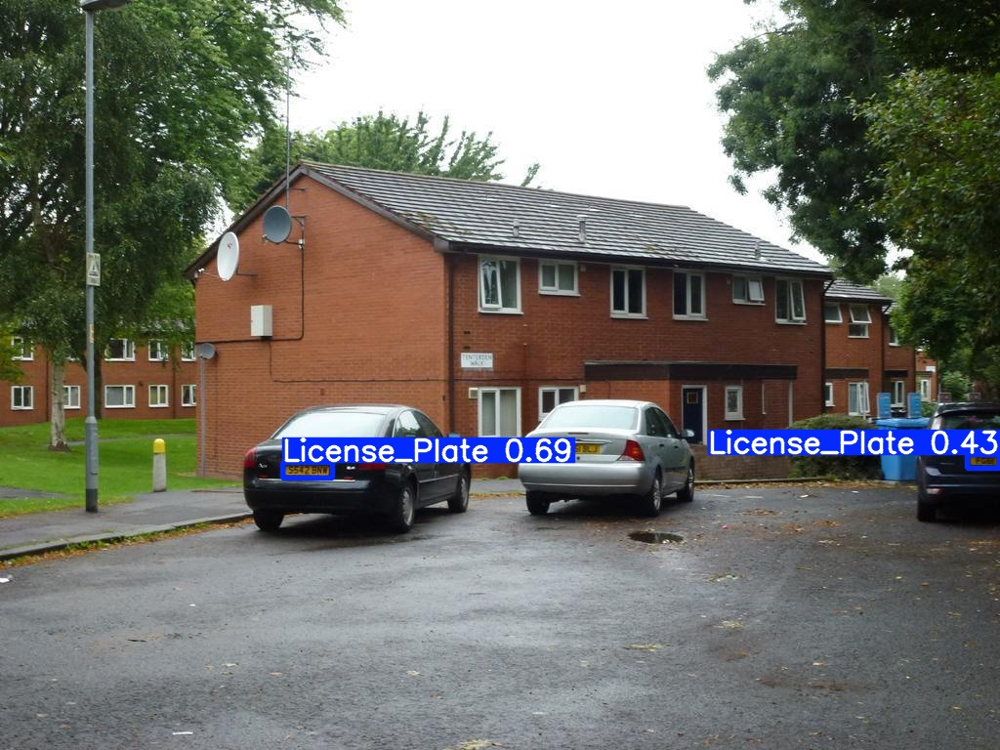

In [ ]:
from ultralytics import YOLO
import glob, random
from pathlib import Path
from IPython.display import Image

model = YOLO("runs/detect/train/weights/best.pt")
img = random.choice(glob.glob("/content/License-Plate-Recognition-11/valid/images/*"))
pred = model.predict(img, imgsz=640, conf=0.25, save=True, project="demo_out", name="img")
Image(filename=str(next((Path("demo_out/img")).glob("*.jpg"))), width=900)


## Example from Youtube

In [ ]:
!pip -q install yt-dlp ultralytics opencv-python-headless


In [ ]:
import yt_dlp

url = "https://www.youtube.com/watch?v=7OIoL7irIF8"  # traffic driving sample

ydl_opts = {
    "format": "best[ext=mp4]",
    "outtmpl": "input_video.%(ext)s"
}
with yt_dlp.YoutubeDL(ydl_opts) as ydl:
    ydl.download([url])


[youtube] Extracting URL: https://www.youtube.com/watch?v=7OIoL7irIF8
[youtube] 7OIoL7irIF8: Downloading webpage
[youtube] 7OIoL7irIF8: Downloading tv client config
[youtube] 7OIoL7irIF8: Downloading player 6742b2b9-main
[youtube] 7OIoL7irIF8: Downloading tv player API JSON
[youtube] 7OIoL7irIF8: Downloading tv simply player API JSON
[info] 7OIoL7irIF8: Downloading 1 format(s): 18
[download] Sleeping 2.00 seconds as required by the site...
[download] Destination: input_video.mp4
[download] 100% of    3.79MiB in 00:00:00 at 11.96MiB/s  


In [ ]:
from ultralytics import YOLO

# load your trained model
model = YOLO("runs/detect/train/weights/best.pt")

# run detection on video
results = model.predict(
    source="input_video.mp4",   # downloaded video
    imgsz=640,
    conf=0.25,
    save=True,
    project="demo_out",
    name="youtube_video"
)

print("Processed video saved to:", "demo_out/youtube_video/input_video.mp4")



WARNING ⚠️ 
inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

video 1/1 (frame 1/1253) /content/input_video.mp4: 384x640 1 License_Plate, 62.2ms
video 1/1 (frame 2/1253) /content/input_video.mp4: 384x640 (no detections), 7.0ms
video 1/1 (frame 3/1253) /content/input_video.mp4: 384x640 (no detections), 7.1ms
video 1/1 (frame 4/1253) /content/input_video.mp4: 384x640 (no detections), 6.7ms
video 1/1 (frame 5/1253) /content/input_video.mp4: 384x640 (no detections), 6.7ms
video 1/1 (frame 6/1253) /content/input_video

In [ ]:
!ffmpeg -i /content/demo_out/youtube_video/input_video.avi \
       -vcodec libx264 -crf 23 -preset veryfast \
       -acodec aac -strict -2 \
       /content/demo_out/youtube_video/input_video.mp4 -y



ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enab

In [ ]:
from IPython.display import Video
Video("/content/demo_out/youtube_video/input_video.mp4", embed=True, width=800)


## Mount Drive & point to file

In [ ]:
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

# <<< path in Drive >>>
INPUT_MOV = "/content/drive/MyDrive/Video_H/IMG_0130.MOV"


Mounted at /content/drive


## convert MOV → MP4 for smoother processing

In [ ]:
!ffmpeg -y -i "$INPUT_MOV" -vcodec libx264 -crf 20 -preset veryfast -acodec aac /content/input_videoP.mp4


ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enab

##Run YOLO plate detector on the video

In [ ]:
from ultralytics import YOLO
from pathlib import Path

model = YOLO("runs/detect/train/weights/best.pt")  # your trained model

res = model.predict(
    source="/content/input_videoP.mp4",   # the mp4 we just made
    imgsz=640,
    conf=0.25,
    save=True,
    project="demo_out",
    name="drive_videoP",
    vid_stride=1
)

# Ultralytics writes output into demo_out/drive_video/
out_dir = Path("demo_out/drive_videoP")
print("Outputs in:", out_dir)
print("Files:", [p.name for p in out_dir.iterdir()])



WARNING ⚠️ 
inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

video 1/1 (frame 1/293) /content/input_videoP.mp4: 384x640 4 License_Plates, 7.9ms
video 1/1 (frame 2/293) /content/input_videoP.mp4: 384x640 4 License_Plates, 10.7ms
video 1/1 (frame 3/293) /content/input_videoP.mp4: 384x640 3 License_Plates, 7.2ms
video 1/1 (frame 4/293) /content/input_videoP.mp4: 384x640 3 License_Plates, 7.0ms
video 1/1 (frame 5/293) /content/input_videoP.mp4: 384x640 3 License_Plates, 7.0ms
video 1/1 (frame 6/293) /content/input_v

In [ ]:
!ffmpeg -i /content/demo_out/drive_videoP/input_videoP.avi \
       -vcodec libx264 -crf 23 -preset veryfast \
       -acodec aac -strict -2 \
       /content/demo_out/drive_videoP/input_videoP.mp4 -y

ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enab

In [ ]:
Video("/content/demo_out/drive_videoP/input_videoP.mp4", embed=True, width=800)

##Zip that contains only what Hailo needs

In [ ]:
# paths (adjust if yours differ)
ONNX="/content/runs/detect/train/weights/best.onnx"
CALIB_DIR="/content/calib_npys"
STAGE="/content/hailo_pkg"



In [ ]:
#  bash
!mkdir -p /content/hailo_pkg
!cp "/content/runs/detect/train/weights/best.onnx" /content/hailo_pkg/best.onnx
!cp -r /content/calib_npys /content/hailo_pkg/


In [ ]:
import os
print("Contents of staging folder:", os.listdir("/content/hailo_pkg"))


Contents of staging folder: ['best.onnx', 'calib_npys']


In [ ]:
import os
print("hailo_pkg contents:", os.listdir("/content/hailo_pkg"))
print("calib_npys contents (first 10):", os.listdir("/content/hailo_pkg/calib_npys")[:10])


hailo_pkg contents: ['best.onnx', 'calib_npys']
calib_npys contents (first 10): ['calib_0116.npy', 'calib_0022.npy', 'calib_0090.npy', 'calib_0169.npy', 'calib_0062.npy', 'calib_0284.npy', 'calib_0253.npy', 'calib_0057.npy', 'calib_0092.npy', 'calib_0212.npy']


In [ ]:
!cd /content && zip -r -q hailo_ready.zip hailo_pkg
!ls -lh /content/hailo_ready.zip


-rw-r--r-- 1 root root 260M Aug 25 18:44 /content/hailo_ready.zip


In [ ]:
from google.colab import files
files.download("/content/hailo_ready.zip")


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>